## **Importing Packages**

In [5]:
# pip install -U graphviz scikit-learn neptune-xgboost xgboost hyperopt mlflow deepchecks
# pip install -U "neptune[xgboost]"

In [6]:
import numpy as np
import os
import pandas as pd
import warnings
from Source.setup import *
from Source.eda import *
from Source.machine_learning import *
warnings.filterwarnings('ignore')

## **Reading and Merging Data**



In [7]:
import pandas as pd

def read_excel_data(file_path, sheet_names):
    data_frames = []
    
    # Read each sheet from the Excel file and store it in a list of DataFrames
    for sheet_name in sheet_names:
        data_frame = pd.read_excel(file_path, sheet_name=sheet_name, engine='openpyxl')
        data_frames.append(data_frame)
    
    return data_frames

In [8]:
# file path of the Excel file containing the dataset
path = r'D:\Megha/PPro/to-do/risk-guard/risk-guard/modular_code/Input/Credit_Risk_Dataset.xlsx'

# read the Excel data
sheet_names= ['loan_information', 'Employment','Personal_information', 'Other_information' ]

dfs = read_excel_data(path, sheet_names)

loan_information = dfs[0]
employment = dfs[1]
personal_information = dfs[2]
other_information = dfs[3]

In [9]:
print(loan_information.columns)
print(employment.columns)
print(other_information.columns)
print(personal_information.columns)

Index(['User_id', 'Loan Category', 'Amount', 'Interest Rate', 'Tenure(years)'], dtype='object')
Index(['User id', 'Employmet type', 'Tier of Employment', 'Industry', 'Role',
       'Work Experience', 'Total Income(PA)'],
      dtype='object')
Index(['User_id', 'Delinq_2yrs', 'Total Payement ', 'Received Principal',
       'Interest Received', 'Number of loans', 'Defaulter'],
      dtype='object')
Index(['User id', 'Gender', 'Married', 'Dependents', 'Home', 'Pincode',
       'Social Profile', 'Is_verified'],
      dtype='object')


In [10]:
loan_information

,User_id,Loan Category,Amount,Interest Rate,Tenure(years)
0,7013527,Consolidation,55884.0,11.84,6
1,7014291,Consolidation,55511.0,16.94,4
2,7014327,Consolidation,12289.0,11.84,6
3,7014304,Credit Card,29324.0,14.71,4
4,7031995,Credit Card,30252.0,14.71,4
...,...,...,...,...,...
134412,55993166,Credit Card,287564.0,12.06,6
134413,56263229,Other,49612.0,14.10,4
134414,55992716,Consolidation,13632.0,18.96,6
134415,56363313,Home,186923.0,8.28,4


In [11]:
personal_information

,User id,Gender,Married,Dependents,Home,Pincode,Social Profile,Is_verified
0,7013527,Female,Yes,4,rent,XX852X,No,NaN
1,7014291,Female,No,1,mortgage,XX286X,NaN,Source Verified
2,7014327,Other,NaN,3,own,XX113X,No,NaN
3,7014304,Male,NaN,1,rent,XX941X,Yes,NaN
4,7031995,Male,NaN,3,rent,XX913X,No,Verified
...,...,...,...,...,...,...,...,...
134412,55993166,Female,No,2,mortgage,XX374X,NaN,Source Verified
134413,56263229,Male,Yes,3,rent,XX436X,No,Source Verified
134414,55992716,Female,Yes,2,rent,XX908X,NaN,NaN
134415,56363313,Other,No,0,mortgage,XX229X,NaN,Source Verified


In [12]:
employment

,User id,Employmet type,Tier of Employment,Industry,Role,Work Experience,Total Income(PA)
0,7013527,Salaried,B,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGAZSEWdkcndwkcnCCM,1-2,125000.0
1,7014291,Self - Employeed,D,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGNCSEWdkcndwkcnCCM,10+,61000.0
2,7014327,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGNYSEWdkcndwkcnCCM,5-10,100000.0
3,7014304,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGCASEWdkcndwkcnCCM,2-3,30000.0
4,7031995,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGCASEWdkcndwkcnCCM,10+,65000.0
...,...,...,...,...,...,...,...
134412,55993166,NaN,NaN,0,KHMbckjadbckIFGTNSEWdkcndwkcnCCM,0,100000.0
134413,56263229,NaN,NaN,0,KHMbckjadbckIFGOHSEWdkcndwkcnCCM,0,27000.0
134414,55992716,NaN,NaN,0,KHMbckjadbckIFGCASEWdkcndwkcnCCM,0,53000.0
134415,56363313,NaN,NaN,0,KHMbckjadbckIFGVASEWdkcndwkcnCCM,0,75400.0


In [13]:
other_information

,User_id,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter
0,7013527,0,1824.150000,971.46,852.69,0,1
1,7014291,0,22912.532998,18000.00,4912.53,0,0
2,7014327,0,7800.440000,4489.76,3310.68,0,1
3,7014304,0,6672.050000,5212.29,1459.76,0,0
4,7031995,0,11793.001345,10000.00,1793.00,0,0
...,...,...,...,...,...,...,...
134412,55993166,1,12842.400000,7193.83,5648.57,0,0
134413,56263229,0,839.200000,581.67,257.53,0,0
134414,55992716,0,6085.800000,2434.49,3651.31,0,0
134415,56363313,0,4080.640000,3286.82,793.82,0,0


In [14]:
# Merge 'loan_information' and 'Employment' dataframes based on 'User_id'
merged_df = pd.merge(loan_information, employment, left_on='User_id', right_on='User id')

# Merge the previously merged dataframe with 'personal_information' based on 'User_id'
merged_df = pd.merge(merged_df, personal_information, left_on='User_id', right_on='User id')

# Merge the previously merged dataframe with 'other_information' based on 'User_id'
merged_df = pd.merge(merged_df, other_information, left_on='User_id', right_on='User_id')

df=merged_df
# Display the first few rows of the merged dataframe
df.head()

,User_id,Loan Category,Amount,Interest Rate,Tenure(years),User id_x,Employmet type,Tier of Employment,Industry,Role,...,Home,Pincode,Social Profile,Is_verified,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter
0,7013527,Consolidation,55884.0,11.84,6,7013527,Salaried,B,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGAZSEWdkcndwkcnCCM,...,rent,XX852X,No,NaN,0,1824.150000,971.46,852.69,0,1
1,7014291,Consolidation,55511.0,16.94,4,7014291,Self - Employeed,D,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGNCSEWdkcndwkcnCCM,...,mortgage,XX286X,NaN,Source Verified,0,22912.532998,18000.00,4912.53,0,0
2,7014327,Consolidation,12289.0,11.84,6,7014327,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGNYSEWdkcndwkcnCCM,...,own,XX113X,No,NaN,0,7800.440000,4489.76,3310.68,0,1
3,7014304,Credit Card,29324.0,14.71,4,7014304,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGCASEWdkcndwkcnCCM,...,rent,XX941X,Yes,NaN,0,6672.050000,5212.29,1459.76,0,0
4,7031995,Credit Card,30252.0,14.71,4,7031995,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGCASEWdkcndwkcnCCM,...,rent,XX913X,No,Verified,0,11793.001345,10000.00,1793.00,0,0


In [15]:
df.columns

Index(['User_id', 'Loan Category', 'Amount', 'Interest Rate', 'Tenure(years)',
       'User id_x', 'Employmet type', 'Tier of Employment', 'Industry', 'Role',
       'Work Experience', 'Total Income(PA)', 'User id_y', 'Gender', 'Married',
       'Dependents', 'Home', 'Pincode', 'Social Profile', 'Is_verified',
       'Delinq_2yrs', 'Total Payement ', 'Received Principal',
       'Interest Received', 'Number of loans', 'Defaulter'],
      dtype='object')

## **Exploratory Data Analysis & Data Preparation**
****






















**Goal: To Understand**

*   **Identify data types of each column**
*  **Understand basic stastistics of all numerical columns**
*   **Check missing values**
*   **Plan for handling missing values**
****
*   **Analyze the distribution of each column**
*   **Assess the quality of data based on the distribution**
*   **Identify any skewness in the data?**
*   **Investigate the reasons behind data skewness**

****
*   **Identify and handle categorical features**
*   **Identify and handle ordinal features**
****

*   **Examine the correlation between different numeric variables**
*   **Examine the correlation between categorical variables**

****
*   **Fix data imbalance**



### **Basic Statistics**

****

In [16]:
# Display data types for each column in the DataFrame. Goal is to see if there is any column with the wrong data type.
df.dtypes

User_id                 int64
Loan Category          object
Amount                float64
Interest Rate         float64
Tenure(years)           int64
User id_x               int64
Employmet type         object
Tier of Employment     object
Industry               object
Role                   object
Work Experience        object
Total Income(PA)      float64
User id_y               int64
Gender                 object
Married                object
Dependents              int64
Home                   object
Pincode                object
Social Profile         object
Is_verified            object
Delinq_2yrs             int64
Total Payement        float64
Received Principal    float64
Interest Received     float64
Number of loans         int64
Defaulter               int64
dtype: object

In [17]:
# We can use describe pandas function to learn basic statistics of all numerical columns in our data.
df.describe()

,User_id,Amount,Interest Rate,Tenure(years),User id_x,Total Income(PA),User id_y,Dependents,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter
count,1.437270e+05,1.118030e+05,143727.000000,143727.000000,1.437270e+05,1.437270e+05,1.437270e+05,143727.000000,143727.000000,143727.000000,143727.000000,143727.000000,143727.000000,143727.000000
mean,3.733474e+07,1.376458e+05,12.038703,4.514503,3.733474e+07,7.242256e+04,3.733474e+07,1.997113,0.276601,10840.882025,8407.001538,2352.729746,0.005573,0.093712
std,3.182811e+07,1.575427e+05,3.880204,0.874241,3.182811e+07,5.539328e+04,3.182811e+07,1.411317,0.789019,8613.421536,7224.396032,2447.759754,0.098785,0.291429
min,2.080360e+05,0.000000e+00,5.420000,4.000000,2.080360e+05,4.000000e+03,2.080360e+05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.276118e+06,2.837950e+04,9.180000,4.000000,3.276118e+06,4.500000e+04,3.276118e+06,1.000000,0.000000,4674.775000,3104.160000,841.685000,0.000000,0.000000
50%,5.766517e+07,7.660300e+04,11.840000,4.000000,5.766517e+07,6.180000e+04,5.766517e+07,2.000000,0.000000,8212.410000,6000.000000,1632.240000,0.000000,0.000000
75%,6.729174e+07,2.054645e+05,14.440000,6.000000,6.729174e+07,8.600000e+04,6.729174e+07,3.000000,0.000000,14175.769677,11664.365000,2904.770000,0.000000,0.000000
max,7.895894e+07,8.000078e+06,23.540000,6.000000,7.895894e+07,7.141778e+06,7.895894e+07,4.000000,22.000000,57777.579870,35000.010000,24205.620000,5.000000,1.000000


### **Handling Missing Values in Data**

In [18]:
# Let's check how many missing values do we have in each column in our dataframe
df.isnull().sum()

User_id                   0
Loan Category             0
Amount                31924
Interest Rate             0
Tenure(years)             0
User id_x                 0
Employmet type        84642
Tier of Employment    84642
Industry                  4
Role                      0
Work Experience           1
Total Income(PA)          0
User id_y                 0
Gender                    0
Married               48143
Dependents                0
Home                      0
Pincode                   0
Social Profile        47856
Is_verified           35803
Delinq_2yrs               0
Total Payement            0
Received Principal        0
Interest Received         0
Number of loans           0
Defaulter                 0
dtype: int64

**Analysis: Handling Missing Values**
* Social profile: Create a new category for NA values.
* Is verified: Create a new category for NA values.
* Married: Create a new category for NA values.
* Industry: Consider dropping missing values.
* Work experience: Consider dropping missing values.
* Amount: Evaluate the impact of removing rows with missing values on the data distribution.
* Employment type: Determine the appropriate approach for handling missing values.
* Tier of employment: Determine the appropriate approach for handling missing values.

In [19]:
# Drop rows with missing values in the 'Industry' and 'Work Experience' columns as the data in 'Industry' is meaningless due to encryption, and 'Work Experience' is inconsistent in the dataset, treating it as an object datatype variable which may impact model performance.
df = df.dropna(subset=['Industry', 'Work Experience'])

In [20]:
# Call the function to replace null values with "missing"
replace_with='missing'
columns_to_replace = ['Social Profile', 'Is_verified', 'Married', 'Employmet type']


df= replace_null_values_with_a_value(df, columns_to_replace, replace_with)

In [21]:
df

,User_id,Loan Category,Amount,Interest Rate,Tenure(years),User id_x,Employmet type,Tier of Employment,Industry,Role,...,Home,Pincode,Social Profile,Is_verified,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter
0,7013527,Consolidation,55884.0,11.84,6,7013527,Salaried,B,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGAZSEWdkcndwkcnCCM,...,rent,XX852X,No,missing,0,1824.150000,971.46,852.69,0,1
1,7014291,Consolidation,55511.0,16.94,4,7014291,Self - Employeed,D,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGNCSEWdkcndwkcnCCM,...,mortgage,XX286X,missing,Source Verified,0,22912.532998,18000.00,4912.53,0,0
2,7014327,Consolidation,12289.0,11.84,6,7014327,missing,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGNYSEWdkcndwkcnCCM,...,own,XX113X,No,missing,0,7800.440000,4489.76,3310.68,0,1
3,7014304,Credit Card,29324.0,14.71,4,7014304,missing,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGCASEWdkcndwkcnCCM,...,rent,XX941X,Yes,missing,0,6672.050000,5212.29,1459.76,0,0
4,7031995,Credit Card,30252.0,14.71,4,7031995,missing,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGCASEWdkcndwkcnCCM,...,rent,XX913X,No,Verified,0,11793.001345,10000.00,1793.00,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
143722,55993166,Credit Card,287564.0,12.06,6,55993166,missing,NaN,0,KHMbckjadbckIFGTNSEWdkcndwkcnCCM,...,mortgage,XX374X,missing,Source Verified,1,12842.400000,7193.83,5648.57,0,0
143723,56263229,Other,49612.0,14.10,4,56263229,missing,NaN,0,KHMbckjadbckIFGOHSEWdkcndwkcnCCM,...,rent,XX436X,No,Source Verified,0,839.200000,581.67,257.53,0,0
143724,55992716,Consolidation,13632.0,18.96,6,55992716,missing,NaN,0,KHMbckjadbckIFGCASEWdkcndwkcnCCM,...,rent,XX908X,missing,missing,0,6085.800000,2434.49,3651.31,0,0
143725,56363313,Home,186923.0,8.28,4,56363313,missing,NaN,0,KHMbckjadbckIFGVASEWdkcndwkcnCCM,...,mortgage,XX229X,missing,Source Verified,0,4080.640000,3286.82,793.82,0,0


In [22]:
#Create a new variable "amount_missing" to indicate if the 'Amount' is missing or not. Assign 1 if 'Amount' is null, otherwise assign 0.
df['amount_missing'] = np.where(df['Amount'].isnull(), 1, 0)

#Replace the null values in the 'Amount' column with the value "-1000" to differentiate them from the rest of the data.
replace_with= - 1000
columns_to_replace = ['Amount']

df= replace_null_values_with_a_value(df, columns_to_replace,replace_with)

In [23]:
# Replace the null values in the 'Tier of Employment' column with the string "Z" to categorize them separately.
replace_with='Z'
columns_to_replace = ['Tier of Employment']

df= replace_null_values_with_a_value(df, columns_to_replace,replace_with)

In [24]:
#Check for null rows in the DataFrame to confirm if the data is clean and does not contain any missing values that could potentially impact the performance of the model.
df.isnull().sum()

User_id               0
Loan Category         0
Amount                0
Interest Rate         0
Tenure(years)         0
User id_x             0
Employmet type        0
Tier of Employment    0
Industry              0
Role                  0
Work Experience       0
Total Income(PA)      0
User id_y             0
Gender                0
Married               0
Dependents            0
Home                  0
Pincode               0
Social Profile        0
Is_verified           0
Delinq_2yrs           0
Total Payement        0
Received Principal    0
Interest Received     0
Number of loans       0
Defaulter             0
amount_missing        0
dtype: int64

### **Drop categorical columns with too many categories**

In [25]:
# Call the function to print the number of unique values in all columns
unique_values_each_column(df)

User_id : 133748
Loan Category : 7
Amount : 86157
Interest Rate : 137
Tenure(years) : 2
User id_x : 133748
Employmet type : 3
Tier of Employment : 8
Industry : 12974
Role : 46
Work Experience : 7
Total Income(PA) : 11380
User id_y : 133748
Gender : 3
Married : 3
Dependents : 5
Home : 5
Pincode : 844
Social Profile : 3
Is_verified : 4
Delinq_2yrs : 22
Total Payement  : 104199
Received Principal : 42021
Interest Received : 93859
Number of loans : 5
Defaulter : 2
amount_missing : 2


**Observations**
- Some columns are ordinal and those categorical variables would need to be treated differently during categorical encoding.
- Address the challenge of categorical columns with a large number of categories. Determine which categories fall into this category and develop a strategy for handling them.

In [26]:
# Dropping Industry Column and User_IDs as it doesn't give any significant information
# Drop 'Pincode' column: Considering privacy concerns, the 'Pincode' data is encrypted. To address these concerns, it is prudent to remove the 'Pincode' column from the dataset.
columns_to_drop = ['Industry', 'User_id','User id_x','User id_y','Pincode','Role']

# Call the function to drop columns
drop_columns(df, columns_to_drop)

,Loan Category,Amount,Interest Rate,Tenure(years),Employmet type,Tier of Employment,Work Experience,Total Income(PA),Gender,Married,...,Home,Social Profile,Is_verified,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter,amount_missing
0,Consolidation,55884.0,11.84,6,Salaried,B,1-2,125000.0,Female,Yes,...,rent,No,missing,0,1824.150000,971.46,852.69,0,1,0
1,Consolidation,55511.0,16.94,4,Self - Employeed,D,10+,61000.0,Female,No,...,mortgage,missing,Source Verified,0,22912.532998,18000.00,4912.53,0,0,0
2,Consolidation,12289.0,11.84,6,missing,Z,5-10,100000.0,Other,missing,...,own,No,missing,0,7800.440000,4489.76,3310.68,0,1,0
3,Credit Card,29324.0,14.71,4,missing,Z,2-3,30000.0,Male,missing,...,rent,Yes,missing,0,6672.050000,5212.29,1459.76,0,0,0
4,Credit Card,30252.0,14.71,4,missing,Z,10+,65000.0,Male,missing,...,rent,No,Verified,0,11793.001345,10000.00,1793.00,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
143722,Credit Card,287564.0,12.06,6,missing,Z,0,100000.0,Female,No,...,mortgage,missing,Source Verified,1,12842.400000,7193.83,5648.57,0,0,0
143723,Other,49612.0,14.10,4,missing,Z,0,27000.0,Male,Yes,...,rent,No,Source Verified,0,839.200000,581.67,257.53,0,0,0
143724,Consolidation,13632.0,18.96,6,missing,Z,0,53000.0,Female,Yes,...,rent,missing,missing,0,6085.800000,2434.49,3651.31,0,0,0
143725,Home,186923.0,8.28,4,missing,Z,0,75400.0,Other,No,...,mortgage,missing,Source Verified,0,4080.640000,3286.82,793.82,0,0,0


**Analysis on Dropping Industry and Pincode**

- Drop 'Industry': As a non-ordinal categorical variable, we need to address the issue of the high number of categories to prevent the model's dimensionality from becoming too large. Since there is no effective way to group these categories into broader categories, it is recommended to drop this column for the time being.

- Convert 'Pincode' to latitude and longitude variables: Considering that 'Pincode' represents location data, it might be beneficial to transform it into latitude and longitude variables. This conversion can provide more meaningful spatial information that can potentially enhance the analysis.




**Analysis on Current DataFrame**
- Employment Type and Tier of Employment: When the employment type is missing, the corresponding tier of employment is also empty. It is important to address these missing values and find an appropriate approach to handle them.

- Missing Data in the Married Column: The presence of missing data in the 'Married' column raises questions about how to interpret this missing information. Considering the impact on machine learning models' performance, it is crucial to decide whether to treat it as a new category or explore the reasons behind the missing values.

- Empty Social Profiles: Empty social profiles can be treated as a distinct category to account for the missing information.

- Is Verified Column: The reason behind the empty values in the 'Is Verified' column is unclear. Assigning a new category to represent these missing values would be a suitable approach.

- Removal of Industry and Work Experience: Since the number of rows with missing values in the 'Industry' and 'Work Experience' columns is minimal (only 4 rows), removing them is unlikely to have a significant impact. Hence, removing these rows can be considered.

- Handling Empty Amounts: Decisions need to be made regarding the rows with missing values in the 'Amount' column. Since the missing values constitute a substantial portion (more than 20%) of the data, careful consideration is required to understand the implications of removing these rows on the data distribution and model performance.
- Drop Industry Variable: The 'Industry' variable has 120,000 occurrences of the value 0, which suggests that it has been encoded and lacks meaningful interpretation. Therefore, dropping the 'Industry' variable temporarily and revisiting it later could be a suitable approach.

### **Multicollinearity**

To assess the relationships between variables in the input DataFrame, we compute the Spearman correlation matrix, that tells how much two variables are correlated.

By examining the heatmap, we can identify potential concerns related to multicollinearity, which occurs when two or more independent variables exhibit high correlation. Multicollinearity can impact the interpretation of the model and lead to overfitting. In such instances, it may be necessary to remove one of the correlated variables to mitigate these issues.

In [27]:
df.dtypes

Loan Category          object
Amount                float64
Interest Rate         float64
Tenure(years)           int64
Employmet type         object
Tier of Employment     object
Work Experience        object
Total Income(PA)      float64
Gender                 object
Married                object
Dependents              int64
Home                   object
Social Profile         object
Is_verified            object
Delinq_2yrs             int64
Total Payement        float64
Received Principal    float64
Interest Received     float64
Number of loans         int64
Defaulter               int64
amount_missing          int32
dtype: object

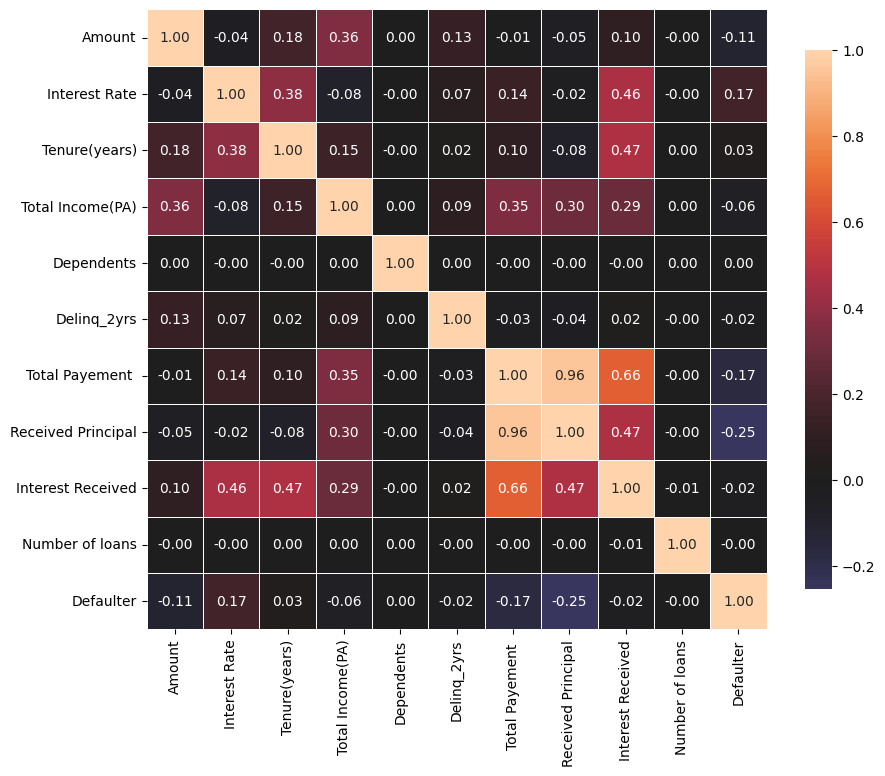

In [28]:
# Multicollinarity is the occurrence of high intercorrelations among two or more independent variables in a multiple regression mode
numeric_columns = df.select_dtypes(include=['float64', 'int64'])

# Plot correlation heatmap
correlation_heatmap(numeric_columns)

**Observation from the heatmap**

No two variables have high correlation with each other, so there is no issue of multicollinearity. It's safe to use all variables in machine learning model building.


**Spearman Correlation Coefficient**

Spearman works best if there are nonlinear relationships between different variables.

****

**We can confirm non-linear relationship b/w features by looking at pair-wise scatter plots below**

There are non-linear relationships b/w features, so our decision of going with spearman was CORRECT.

#### **Scatter Plots to visualize correlations between x variables**

The following code generates a scatter plot matrix, also known as a pair plot, of all numeric features in the input DataFrame using the seaborn library.

The diagonal of the plot matrix shows a histogram of each variable's distribution. This allows for visual inspection of the pairwise relationships between variables, which can be useful for identifying patterns, trends, correlations, or potential outliers in the data.

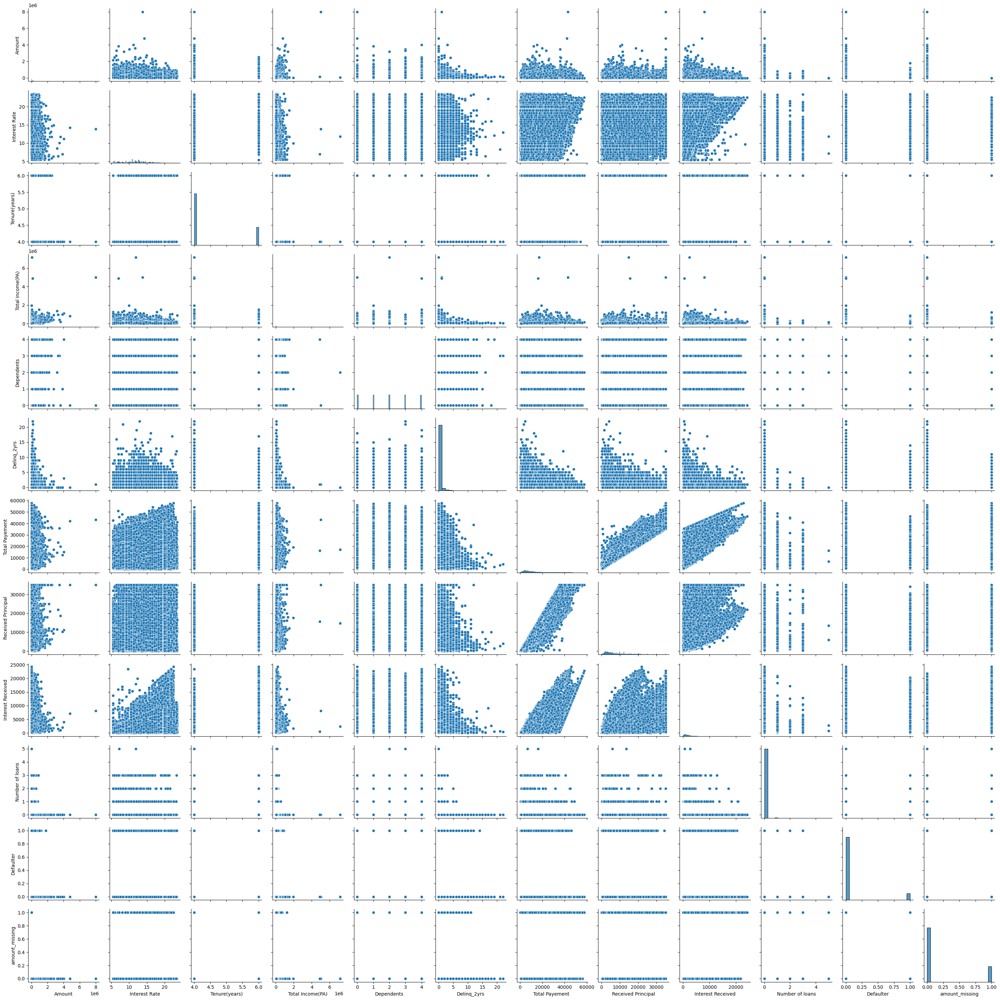

In [29]:
# Let's plot all interaction scatter plots using seaborn

# Call the function to plot pairwise scatter plots
plot_pairwise_scatter(df)



**Analysis**

****

- Scatterplots can help us confirm multicollinearity between two variables. We  can look at the scatterplot to check if there is any pattern or correlation between two variables.**

- Multicollinearity makes explainability less trustworthy as change in one variablte will not only impact the target variable but also impact other X variables. Means how much does a variable impact target variable would be hard



### **Skewness**

#### **Understand Skewness**

In [30]:
# To identify anomalies in each column, it is essential to examine the distributions of the variables in the dataset.

# Call the function to plot histograms
Feature_Distributions_Histogram(df)

**Concept of skewness:**

Imagine a seesaw in a playground. If the seesaw is perfectly balanced, it means both ends are at the same height and there is no tilt. Similarly, a symmetric distribution has equal amounts of data on both sides of the central point, resulting in a balance.

However, if the seesaw is tilted to one side, it indicates an imbalance. Similarly, if a distribution is skewed, it means there is more data concentrated on one side compared to the other. This imbalance causes the distribution to have a "tail" that stretches towards the side with fewer data points.

Skewness helps us understand the direction and degree of this imbalance. If the tail stretches to the right side, we call it positive skewness, indicating a longer right tail. Conversely, if the tail stretches to the left side, we call it negative skewness, indicating a longer left tail.

**Positive skewness:**

Imagine a line plot or histogram representing the heights of students in a class. In a class with right skewness, most students will have heights clustered towards the shorter side, and there will be a few students with taller heights. The right tail of the distribution will be longer, indicating the presence of outliers or extreme values on the taller side.

**Negative Skewness:**
Consider a line plot or histogram representing the time spent studying for an exam. In a situation with left skewness, most students might have relatively high study times, and there will be a few students with very low study times. The left tail of the distribution will be longer, indicating the presence of outliers or extreme values on the lower side.

**Analysis after Distribution:**

1. Amount: The distribution of the 'Amount' variable is right-skewed, indicating that a majority of loan amounts are lower, while a few instances have higher values.

2. Employment Type: The distribution of the 'Employment Type' variable shows an imbalance, suggesting that certain employment types may be overrepresented in the dataset compared to others.

3. Work Experience: The 'Work Experience' variable also exhibits imbalanced data, implying that certain levels of work experience may be more prevalent than others.

4. Pincode: The 'Pincode' variable contains a large number of categories, which may pose challenges for analysis. Considering converting it into latitude and longitude coordinates could offer a more manageable representation.

5. Delinq_2years: The distribution of the 'Delinq_2years' variable is right-skewed, indicating that most individuals have a low number of delinquencies, while a few have a higher count.

6. Payment: The 'Payment' variable displays a right-skewed distribution, suggesting that the majority of payment amounts are lower, with a few instances of higher payments.
7. Received Principal: The distribution of the 'Received Principal' variable is right-skewed, indicating that most individuals have received a lower principal amount, while a few have received a higher amount.

8. Interest Received: The 'Interest Received' variable exhibits a right-skewed distribution, suggesting that the majority of individuals have received a lower interest amount, while a few have received a higher interest payment.

**Outcome**

The resulting histograms will show the distribution of values in each column and can help identify potential outliers or anomalies in the data. For example, if a column has a very skewed distribution or contains a large number of extreme values, this may indicate that the data is not representative or that there are errors or issues with the data collection process.

Note that generating histograms for a large number of columns can be computationally intensive and may take some time to run, especially for large datasets.

#### **Fixing Skewness in the Data**

**Skewness**

- Skewness is a statistical measure that describes the asymmetry or lack of symmetry in a distribution. It provides insights into the shape of the distribution and the relative positioning of the mean, median, and mode.
- A positive skewness value indicates a right-skewed distribution, where the tail is elongated towards the right. A negative skewness value indicates a left-skewed distribution, where the tail is elongated towards the left. A skewness value of 0 indicates a symmetric distribution.
- By quantifying skewness, we can gain a numerical understanding of the distribution's asymmetry and further analyze its implications in data analysis and modeling


**How to quantify skewness?**

* skewness = 3 * (mean - median) / standard deviation.

****
**Question to consider**

* Should we remove outliers/extreme values first and then fix skewness or the otherway around?
****
**Decision**
* To address the presence of outliers in skewed data, we'll first correct the skewness.
* One approach to mitigating the impact of outliers is by utilizing the z-score. The z-score measures how many standard deviations an individual data point is away from the mean. By setting a threshold, such as 3 standard deviations, data points that exceed this threshold can be considered as outliers and subsequently removed from the dataset.


**Let's print skewness in each feature and use log transformation to fix skewness.**

**Note**

It is important to note that there are numerous features in the dataset with a value of 0. To address this issue and normalize the data, we can apply a log transformation specifically to the non-zero values. By taking the logarithm of these values, we can achieve a more symmetric distribution and reduce the impact of extreme values. This transformation can be particularly useful when working with skewed data or variables that exhibit a wide range of values.

Let's only transform features if skewness is in the following range
* **Skewness < -3 OR Skewness > 3**


In [31]:
# Add all the features to check and fix skewness in features_log array
# features_log= ['Amount','Interest Rate','Tenure(years)','Dependents','Total Payement ','Received Principal','Interest Received']

# df= fix_skewness(df, features_log)


### **One Hot Encoding of Categorical Features and Ordinal Encoding of Ordinal Features**




**Categorical and Ordinal Variables**

Categorical variables refer to variables that represent discrete categories or labels, such as gender (male/female), marital status (single/married/divorced), or product types (A/B/C). These variables do not have a specific numerical order or hierarchy.

On the other hand, ordinal variables also represent discrete categories, but they have an inherent order or ranking associated with them. Examples of ordinal variables include education level (elementary/middle/high school/college), employment status (unemployed/part-time/full-time), or customer satisfaction rating (low/medium/high).

#### **Categorical Hot-Encoding**

In [32]:
import pandas as pd

# Add all categorical features for categorical one-hot encoding in categorical_features array
data = df
categorical_features= ["Gender", "Married", "Home", "Social Profile", "Loan Category", "Employmet type","Is_verified", ]

# Perform one-hot encoding using pandas get_dummies() function
encoded_data = pd.get_dummies(data, columns=categorical_features)



In [33]:
encoded_data

,Amount,Interest Rate,Tenure(years),Tier of Employment,Work Experience,Total Income(PA),Dependents,Delinq_2yrs,Total Payement,Received Principal,...,Loan Category_Home,Loan Category_Medical,Loan Category_Other,Employmet type_Salaried,Employmet type_Self - Employeed,Employmet type_missing,Is_verified_Not Verified,Is_verified_Source Verified,Is_verified_Verified,Is_verified_missing
0,55884.0,11.84,6,B,1-2,125000.0,4,0,1824.150000,971.46,...,0,0,0,1,0,0,0,0,0,1
1,55511.0,16.94,4,D,10+,61000.0,1,0,22912.532998,18000.00,...,0,0,0,0,1,0,0,1,0,0
2,12289.0,11.84,6,Z,5-10,100000.0,3,0,7800.440000,4489.76,...,0,0,0,0,0,1,0,0,0,1
3,29324.0,14.71,4,Z,2-3,30000.0,1,0,6672.050000,5212.29,...,0,0,0,0,0,1,0,0,0,1
4,30252.0,14.71,4,Z,10+,65000.0,3,0,11793.001345,10000.00,...,0,0,0,0,0,1,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
143722,287564.0,12.06,6,Z,0,100000.0,2,1,12842.400000,7193.83,...,0,0,0,0,0,1,0,1,0,0
143723,49612.0,14.10,4,Z,0,27000.0,3,0,839.200000,581.67,...,0,0,1,0,0,1,0,1,0,0
143724,13632.0,18.96,6,Z,0,53000.0,2,0,6085.800000,2434.49,...,0,0,0,0,0,1,0,0,0,1
143725,186923.0,8.28,4,Z,0,75400.0,0,0,4080.640000,3286.82,...,1,0,0,0,0,1,0,1,0,0


#### **Ordinal Encoding**

In [34]:
# Define the ordinal categorical features array
ordinal_features = ["Tier of Employment", "Work Experience"]

# Define the pandas DataFrame for encoding
data = encoded_data
data

,Amount,Interest Rate,Tenure(years),Tier of Employment,Work Experience,Total Income(PA),Dependents,Delinq_2yrs,Total Payement,Received Principal,...,Loan Category_Home,Loan Category_Medical,Loan Category_Other,Employmet type_Salaried,Employmet type_Self - Employeed,Employmet type_missing,Is_verified_Not Verified,Is_verified_Source Verified,Is_verified_Verified,Is_verified_missing
0,55884.0,11.84,6,B,1-2,125000.0,4,0,1824.150000,971.46,...,0,0,0,1,0,0,0,0,0,1
1,55511.0,16.94,4,D,10+,61000.0,1,0,22912.532998,18000.00,...,0,0,0,0,1,0,0,1,0,0
2,12289.0,11.84,6,Z,5-10,100000.0,3,0,7800.440000,4489.76,...,0,0,0,0,0,1,0,0,0,1
3,29324.0,14.71,4,Z,2-3,30000.0,1,0,6672.050000,5212.29,...,0,0,0,0,0,1,0,0,0,1
4,30252.0,14.71,4,Z,10+,65000.0,3,0,11793.001345,10000.00,...,0,0,0,0,0,1,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
143722,287564.0,12.06,6,Z,0,100000.0,2,1,12842.400000,7193.83,...,0,0,0,0,0,1,0,1,0,0
143723,49612.0,14.10,4,Z,0,27000.0,3,0,839.200000,581.67,...,0,0,1,0,0,1,0,1,0,0
143724,13632.0,18.96,6,Z,0,53000.0,2,0,6085.800000,2434.49,...,0,0,0,0,0,1,0,0,0,1
143725,186923.0,8.28,4,Z,0,75400.0,0,0,4080.640000,3286.82,...,1,0,0,0,0,1,0,1,0,0


In [35]:

# Create a custom mapping of categories to numerical labels
tier_employment_order= list(encoded_data["Tier of Employment"].unique())
tier_employment_order.sort()
tier_employment_order

['A', 'B', 'C', 'D', 'E', 'F', 'G', 'Z']

In [36]:

work_experience_order= [ '0', '<1', '1-2', '2-3', '3-5', '5-10','10+']


In [37]:

custom_mapping = [tier_employment_order, work_experience_order]
custom_mapping

[['A', 'B', 'C', 'D', 'E', 'F', 'G', 'Z'],
 ['0', '<1', '1-2', '2-3', '3-5', '5-10', '10+']]

In [38]:
ordinal_features

['Tier of Employment', 'Work Experience']

In [39]:
unique_values = df['Work Experience'].unique()

# Print or do whatever you want with the unique values
print(unique_values)

['1-2' '10+' '5-10' '2-3' '3-5' '0' '<1']


In [40]:

# Call the function to perform ordinal encoding
data = perform_ordinal_encoding(data, ordinal_features, custom_mapping)

In [41]:
data

,Amount,Interest Rate,Tenure(years),Tier of Employment,Work Experience,Total Income(PA),Dependents,Delinq_2yrs,Total Payement,Received Principal,...,Loan Category_Home,Loan Category_Medical,Loan Category_Other,Employmet type_Salaried,Employmet type_Self - Employeed,Employmet type_missing,Is_verified_Not Verified,Is_verified_Source Verified,Is_verified_Verified,Is_verified_missing
0,55884.0,11.84,6,1.0,2.0,125000.0,4,0,1824.150000,971.46,...,0,0,0,1,0,0,0,0,0,1
1,55511.0,16.94,4,3.0,6.0,61000.0,1,0,22912.532998,18000.00,...,0,0,0,0,1,0,0,1,0,0
2,12289.0,11.84,6,7.0,5.0,100000.0,3,0,7800.440000,4489.76,...,0,0,0,0,0,1,0,0,0,1
3,29324.0,14.71,4,7.0,3.0,30000.0,1,0,6672.050000,5212.29,...,0,0,0,0,0,1,0,0,0,1
4,30252.0,14.71,4,7.0,6.0,65000.0,3,0,11793.001345,10000.00,...,0,0,0,0,0,1,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
143722,287564.0,12.06,6,7.0,0.0,100000.0,2,1,12842.400000,7193.83,...,0,0,0,0,0,1,0,1,0,0
143723,49612.0,14.10,4,7.0,0.0,27000.0,3,0,839.200000,581.67,...,0,0,1,0,0,1,0,1,0,0
143724,13632.0,18.96,6,7.0,0.0,53000.0,2,0,6085.800000,2434.49,...,0,0,0,0,0,1,0,0,0,1
143725,186923.0,8.28,4,7.0,0.0,75400.0,0,0,4080.640000,3286.82,...,1,0,0,0,0,1,0,1,0,0


### **Fix data imbalance in the target variable**

**Oversampling**

 Increase the number of instances in the minority class (defaulters) by duplicating existing examples or generating synthetic examples to achieve a balanced dataset.

In [42]:
data.shape

(143723, 42)

In [43]:
# Specify the name of the target variable column
target_column="Defaulter"

X, y= fix_imbalance_using_oversamping(data, target_column)


In [44]:
X.shape, y.shape

((260508, 41), (260508,))

**SMOTE**

SMOTE (Synthetic Minority Over-sampling Technique) is a popular technique used in machine learning and data mining to address the issue of imbalanced datasets. Imbalanced datasets are characterized by a significant difference in the number of instances between the classes, where one class (the minority class) has a much smaller representation than the other class(es) (the majority class(es)).

SMOTE works by generating synthetic samples for the minority class to balance the class distribution. It does this by creating synthetic examples along the line segments connecting minority class instances. Here's a high-level overview of how SMOTE works:

For each instance in the minority class, SMOTE selects one or more of its k nearest neighbors from the same class. The value of k is a user-defined parameter.
Synthetic samples are created by randomly selecting one or more of the nearest neighbors and using them to form new samples. This is done by interpolating the feature values between the selected instance and its neighbor(s). For example, if there are two nearest neighbors, SMOTE can create a synthetic sample by taking a weighted average of the feature values of the two neighbors.
The synthetic samples are added to the dataset, effectively increasing the representation of the minority class. This process is repeated until the desired balance between the classes is achieved.
SMOTE helps to overcome the problem of imbalanced datasets by increasing the diversity of the minority class and reducing the bias towards the majority class during training. This can improve the performance of machine learning models by ensuring that the model is exposed to a more balanced representation of the data.


In [45]:
# import pandas as pd
# from imblearn.over_sampling import SMOTE

# # Assuming you have your pandas DataFrame df with features and target variable

# # Separate the features (X) and target variable (y) from the DataFrame
# X = data.drop('Defaulter', axis=1)
# y = data['Defaulter']

# # Initialize the SMOTE oversampling algorithm
# smote = SMOTE(random_state=42)

# # Convert X and y to NumPy arrays
# X_array = X.values
# y_array = y.values

# # Perform oversampling on the data
# X_resampled, y_resampled = smote.fit_resample(X_array, y_array)

# # Convert the resampled arrays back to a pandas DataFrame
# X_resampled_df = pd.DataFrame(X_resampled, columns=X.columns)
# y_resampled_df = pd.DataFrame(y_resampled, columns=['target'])

# # Print the class distribution before and after oversampling
# print("Class distribution before oversampling:")
# print(y.value_counts())

# print("Class distribution after oversampling:")
# print(y_resampled_df['target'].value_counts())

# X= X_resampled_df
# y= y_resampled_df


## **Split Data in training, validation, and testing datasets**

In [46]:
from sklearn.model_selection import train_test_split

#The test_size parameter is set to 0.2, indicating that 20% of the data will be allocated to the testing set, while the remaining 80% will be used for training.
#The random_state parameter is set to 42 to ensure reproducibility of the split, meaning that the same random split will be obtained each time the code is executed.
train_x, test_x, train_y, test_y = train_test_split(X, y, test_size=0.2, random_state=42)
train_x.shape, test_x.shape, train_y.shape, test_y.shape
# val_x, test_x, val_y, test_y = train_test_split(test_x, test_y, test_size=0.5, random_state=42)


((208406, 41), (52102, 41), (208406,), (52102,))

## **Model Training: Xgboost**

### **Import packages**

In [47]:
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
import xgboost as xgb

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

from hyperopt import fmin, tpe, hp, STATUS_OK
from hyperopt.pyll import scope
import numpy as np

import neptune
import time
from neptune.integrations.xgboost import NeptuneCallback


import pickle
from sklearn.metrics import classification_report, confusion_matrix

### **Configure Neptune**

Format:

# Create a Neptune run object
run = neptune.init_run(
    project="your-workspace-name/your-project-name",  
    api_token="YourNeptuneApiToken",  
    tags=["quickstart", "script"],  # optional
)

In [48]:
# # Configure Neptune
# run = neptune.init_run(
#     project="riskguard/riskguard",
#     api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiJkNmI2ZmJkYi03NjFlLTQwNDItYmM5OS00ZmQwZTU2N2U4NTMifQ=="
# )  #credentials

# # Creating a NeptuneCallback object to integrate Neptune with XGBoost.
# neptune_callback = NeptuneCallback(run=run, log_tree=[0, 1, 2, 3])


### **Model training with hyperopt**

**XGBoost hyperparameters**
***
- **Boosting hyperparameters:** Control the gradient descent process in boosting.

- **Tree hyperparameters:** Influence the construction of decision trees.

- **Stochastic hyperparameters:** Determine the subsampling of training data during model building.

- **Regularization hyperparameters:** Regulate model complexity to prevent overfitting.
***

In [49]:
# # Define search space for hyperparameter tuning of XGBoost model.
# search_space = {
#     'learning_rate': hp.loguniform('learning_rate', -7, 0),
#     'max_depth': scope.int(hp.uniform('max_depth', 1, 100)),
#     'min_child_weight': hp.loguniform('min_child_weight', -2, 3),
#     'subsample': hp.uniform('subsample', 0.5, 1),
#     'colsample_bytree': hp.uniform('colsample_bytree', 0.5, 1),
#     'gamma': hp.loguniform('gamma', -10, 10),
#     'alpha': hp.loguniform('alpha', -10, 10),
#     'lambda': hp.loguniform('lambda', -10, 10),
#     'objective': 'binary:logistic',
#     'eval_metric': 'error',
#     'seed': 123,
# }
# train_x=train_x
# train_y=train_y
# test_x=test_x
# test_y=test_y


# # Finding the best hyperparameters using Hyperopt's fmin function.
# best_params = fmin(
#     fn=lambda params: train_model_xgboost(params, neptune_callback, train_x, train_y, test_x, test_y),
#     space=search_space,
#     algo=tpe.suggest,
#     max_evals=200,
#     rstate=np.random.default_rng(123)
# )
# run.stop()

# print(best_params)



### **Best fit xgboost model**


In [50]:
# # Access the best hyperparameters
# best_hyperparams = {k: best_params[k] for k in best_params}

# # Train the final XGBoost model with the best hyperparameters
# final_model = xgb.XGBClassifier(
#     max_depth=int(best_hyperparams['max_depth']),
#     learning_rate=best_hyperparams['learning_rate'],
#     gamma=best_hyperparams['gamma'],
#     subsample=best_hyperparams['subsample'],
#     colsample_bytree=best_hyperparams['colsample_bytree'],
#     random_state=42,
#     tree_method='hist',enable_categorical= True,
# )

# final_model.fit(train_x, train_y)  # Train the final model on the entire dataset

### Save the model as a pkl file

In [51]:
import pickle

# filename = r'D:\Megha\PPro\to-do\risk-guard\risk-guard\Notebook\output\xgboost_model.pkl'
# pickle.dump(final_model, open(filename, 'wb'))

# Load the model from the file
filename = r'D:\Megha\PPro\to-do\risk-guard\risk-guard\Notebook\output\xgboost_model.pkl'
xgboost = pickle.load(open(filename, 'rb'))


### **Model validation**

In [52]:
# # `test_x` contains test feature data
# #`test_y` contains test target labels
# from sklearn.metrics import classification_report, confusion_matrix

# y_pred = final_model.predict(test_x)

# print("Classification Report:")
# print(classification_report(test_y, y_pred))

# print("Confusion Matrix:")
# print(confusion_matrix(test_y, y_pred))

In [53]:
# `test_x` contains test feature data
#`test_y` contains test target labels
# Load the model from the file
filename = r'D:\Megha\PPro\to-do\risk-guard\risk-guard\Notebook\output\xgboost_model.pkl'
xgboost = pickle.load(open(filename, 'rb'))

from sklearn.metrics import classification_report, confusion_matrix

y_pred = xgboost.predict(test_x)

print("Classification Report:")
print(classification_report(test_y, y_pred))

print("Confusion Matrix:")
print(confusion_matrix(test_y, y_pred))

Classification Report:
              precision    recall  f1-score   support

           0       0.78      0.80      0.79     25937
           1       0.80      0.77      0.78     26165

    accuracy                           0.79     52102
   macro avg       0.79      0.79      0.79     52102
weighted avg       0.79      0.79      0.79     52102

Confusion Matrix:
[[20786  5151]
 [ 5980 20185]]


### **Save data to pkl**

In [54]:

# Read the testing data
# filename = r'D:\Megha\PPro\to-do\risk-guard\risk-guard\Notebook\output\testing_data_iteration2.pkl'
# with open(filename, 'rb') as file:
#     test_x, test_y = pickle.load(file)


# # Read the training data
# filename2 = r'D:\Megha\PPro\to-do\risk-guard\risk-guard\Notebook\output\training_data_iteration2.pkl'
# with open(filename2, 'rb') as file:
#     train_x, train_y= pickle.load(file)


In [55]:
test_x, test_y, train_x, train_y

(          Amount  Interest Rate  Tenure(years)  Tier of Employment  \
 238444   -1000.0          13.23              4                 2.0   
 170163   41740.0          16.70              4                 7.0   
 40294    -1000.0          10.95              4                 1.0   
 88429    26279.0           5.86              4                 7.0   
 78470    36031.0          14.08              6                 7.0   
 ...          ...            ...            ...                 ...   
 136932   69496.0           8.28              4                 1.0   
 29217    26987.0          16.70              4                 3.0   
 237470   97721.0          14.27              4                 2.0   
 27733    53461.0          11.84              4                 1.0   
 33379   192027.0          16.94              6                 3.0   
 
         Work Experience  Total Income(PA)  Dependents  Delinq_2yrs  \
 238444              0.0           55000.0           3            3   
 170

## **Model Training: RandomForest**

### **Random forest Grid Search**

In [56]:
# # Define your parameter grid
# param_grid = {
#         'n_estimators': [100, 200, 300],
#         'max_depth': [0, 5, 10],
#         'min_samples_split': [2, 5, 10]
#     }


# best_parameters=random_forest_classifier_grid_search(param_grid, train_x, train_y)

# best_parameters

**Best Parameters:**
- **'max_depth'**: None
- **'min_samples_split'**: 2
- **'n_estimators'**: 300

### **Model Validation Random Forest**

In [57]:
# from sklearn.metrics import classification_report, confusion_matrix

# # Access the best hyperparameters
# best_hyperparams = {k: best_parameters[k] for k in best_parameters}

# # Train the randomforest model with the best hyperparameters
# final_model1 = RandomForestClassifier(
#     max_depth=best_hyperparams['max_depth'],
#     min_samples_split=best_hyperparams['min_samples_split'],
#     n_estimators=best_hyperparams['n_estimators'],
# )

# final_model1.fit(train_x, train_y)  # Train the final model on the entire dataset



### **Save Random Forest**

In [58]:
# import pickle

# filename = r'D:\Megha\PPro\to-do\risk-guard\risk-guard\Notebook\output\RandomForest_model.pkl'

# save the model into the file
# pickle.dump(final_model1, open(filename, 'wb'))


# Load the model using the lines below
filename = r'D:\Megha\PPro\to-do\risk-guard\risk-guard\Notebook\output\RandomForest_model.pkl'
final_model1 = pickle.load(open(filename, 'rb'))

# Make predictions on the test data
y_pred = final_model1.predict(test_x)

# Print classification metrics
print("Classification Report:")
print(classification_report(test_y, y_pred))

print("Confusion Matrix:")
print(confusion_matrix(test_y, y_pred))

Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.90      0.85     25937
           1       0.89      0.79      0.84     26165

    accuracy                           0.85     52102
   macro avg       0.85      0.85      0.85     52102
weighted avg       0.85      0.85      0.85     52102

Confusion Matrix:
[[23349  2588]
 [ 5371 20794]]


# **Explainable AI**

In [59]:
import pandas as pd
import numpy as np

import xgboost as xgb
from sklearn.metrics import classification_report, roc_auc_score
import matplotlib.pyplot as plt
import shap
import pickle

In [60]:
filename = r'D:\Megha\PPro\to-do\risk-guard\risk-guard\Notebook\output\RandomForest_model.pkl'
filename2 = r'D:\Megha\PPro\to-do\risk-guard\risk-guard\Notebook\output\xgboost_model.pkl'
# Load the model from the file
final_model_rf = pickle.load(open(filename, 'rb'))
final_model_xgb = pickle.load(open(filename2, 'rb'))

In [61]:
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np

# # Read the testing data to a file
# filename = r'D:\Megha\PPro\to-do\risk-guard\risk-guard\Notebook\output\testing_data_iteration2.pkl'
# with open(filename, 'rb') as file:
#     test_x, test_y = pickle.load(file)


test_y_array = test_y.to_numpy()

# Make predictions on the test data
y_pred = final_model_xgb.predict(test_x)

# Print classification metrics
print("Classification Report:")
print(classification_report(test_y_array, y_pred))

print("Confusion Matrix:")
print(confusion_matrix(test_y_array, y_pred))



Classification Report:
              precision    recall  f1-score   support

           0       0.78      0.80      0.79     25937
           1       0.80      0.77      0.78     26165

    accuracy                           0.79     52102
   macro avg       0.79      0.79      0.79     52102
weighted avg       0.79      0.79      0.79     52102

Confusion Matrix:
[[20786  5151]
 [ 5980 20185]]


In [62]:
# # Make predictions on the test data
# y_pred = final_model_rf.predict(test_x)

# # Print classification metrics
# print("Classification Report:")
# print(classification_report(test_y_array, y_pred))

# print("Confusion Matrix:")
# print(confusion_matrix(test_y_array, y_pred))


### **Interpretation for the Business Stakeholders and Regulators**

|  | Actual Positive (Default) | Actual Negative (Non-Default) |
| --- | --- | --- |
| Predicted Positive (Default) | TP | FP |
| Predicted Negative (Non-Default) | FN | TN |



|  | Actual Default | Actual Non-Default |
| --- | --- | --- |
| Predicted Default | 23349 | 2588 |
| Predicted Non-Default | 5371 | 20794 |

**False Positives (FP):** False positives occur when the model predicts a loan as default, but it actually is a non-default. In the given confusion matrix, the FP value is 2588. False positives can have the following impacts:

- If the model generates a high number of false positives due to biases, it may incorrectly classify deserving borrowers as high-risk or default-prone. Biases in the data or model can disproportionately affect certain groups, leading to the denial of loans to individuals who are actually creditworthy. This not only hampers opportunities for those individuals but also results in missed business opportunities for the lending institution.
- False positives can also result in customer dissatisfaction and harm the reputation of the lending institution. Applicants who are wrongly classified as default risks may feel unfairly treated, leading to loss of trust and potential business for the institution.
- Processing loan applications that are eventually rejected due to false positives can impose additional operational costs on the lending institution, impacting efficiency and profitability.

**False Negatives (FN):** False negatives occur when the model predicts a loan as non-default, but it actually is a default. In the given confusion matrix, the FN value is 5371. False negatives can have the following impacts:

- If the model generates a high number of false negatives, it may grant loans to borrowers who are likely to default. This can result in increased loan defaults and financial losses for the lending institution.
- Granting loans to borrowers who are likely to default can raise concerns from regulatory bodies, potentially leading to penalties, legal issues, or damage to the reputation of the lending institution.

**To illustrate the impact, let's consider some hypothetical values for the cost of loss:**

- Cost of FP: 10,000 (Let's assume that the average amount of loan given to the customer is more than 10,000 and a lending institution will lose 10,000 on average if someone doesn’t default. This is the cost associated with incorrectly classifying a loan as default)
- Cost of FN: 50,000 (Let's assume that the average amount of loan given to the customer is more than 50,000, and a lending institution will lose 50,000 on average if someone default. This is the cost associated with incorrectly classifying a loan as non-default)

Using these values, we can calculate the total cost of errors based on the confusion matrix:

Total Cost = (FP * Cost of FP) + (FN * Cost of FN)

Total Cost = (2588 * 10000) + (5371 * 50,000)

Total Cost = 294.43 million

The total cost of errors depends on the specific cost values assigned to FP and FN and can help assess the financial impact of misclassifications in the loan default use case. By adjusting the cost values, organizations can prioritize minimizing the type of error that incurs higher financial losses and optimize their model accordingly.

### **Interpretation of Data Scientists**




In this section, we will learn how to use confusion metrics, precision, recall, and other concepts to explain to fellow data scientists how to improve the machine learning model.

**Confusion matrix:**

|  | Actual Default | Actual Non-Default |
| --- | --- | --- |
| Predicted Default | TP | FP |
| Predicted Non-Default | FN | TN |

|  | Actual Default | Actual Non-Default |
| --- | --- | --- |
| Predicted Default | 23349 | 2588 |
| Predicted Non-Default | 5371 | 20794 |

Based on the confusion matrix above, our precisions, recall and f1 scores are,

**Recall for default = TP / (TP + FN)**

**Precision =** **TP / (TP + FP)**

**F1 Score =** **2 * (Precision * Recall) / (Precision + Recall)**

|  | Precision | Recall | F1-Score |
| --- | --- | --- | --- |
| Default (1) | TP / (TP + FP) | TN / (TN + FP) | 0.84 |
| Non-Default (0) | TN/ (TN + FN) | TP / (TP + FN) | 0.85 |

|  | Precision | Recall | F1-Score |
| --- | --- | --- | --- |
| Default (1) | 0.89 | 0.79 | 0.84 |
| Non-Default (0) | 0.81 | 0.90 | 0.85 |

**Recall for Non-Default (0) = 23349   / (23349   + 2588) = 0.90**

**Recall for Default (1) = 20794 / (20794 + 5371 ) = 0.79**

In the previous section, we established

1. The cost of giving a loan to potential defaulters is 50,000 * 5371 = 268.55 million. This cost represents the potential loss incurred when loans are granted to individuals who are likely to default.
2. The cost of not giving the loan to non-defaulters is 10,000 * 2588  = 25.88 million. This cost represents missed business opportunities and potential revenue when loans are denied to individuals who would not default.
3. Considering the higher cost associated with giving loans to potential defaulters, it becomes a priority for data scientists to tune the model to reduce false negatives. This implies that the focus should be on improving both precision and recall for non-defaulters.
4. We can tell the data scientists that we have to reduce FN to increase the precision and recall for non-defaulters.
5. Data Scientists may explore various approaches, such as fine-tuning the model, optimizing feature selection, or incorporating additional relevant data sources.
6. Ultimately, the goal is to strike a balance between minimizing the risk of default by accurately identifying potential defaulters while avoiding unnecessary loan denials to creditworthy individuals. This strategy can help mitigate losses and ensure responsible lending practices, benefiting both the lending institution and its customers.

In [63]:
def filter_test_data_based_actual_prediction(test_x, test_y, y_pred, actual=1, prediction=0  ):
  
  ## Filter False negatives

  # Assuming you have a DataFrame called df and a numpy array called y_pred

  # Convert the numpy array to a pandas Series
  Predictions = pd.Series(y_pred, name='Predictions')

  # Merge the Series with the DataFrame
  merged_df = pd.concat([test_y, Predictions], axis=1)

  filtered_df = merged_df[(merged_df['Defaulter'] == actual) & (merged_df['Predictions'] == prediction)]


  # Assuming you have the 'test_x' DataFrame and 'filtered_df' DataFrame already defined

  # Get the index of the filtered_df
  filtered_index = filtered_df.index

  # Filter the test_x DataFrame based on the same index
  filtered_test_x = test_x.loc[filtered_index]

  # Concatenate test_x and filtered_df along the columns axis
  concatenated_df = pd.concat([filtered_test_x, filtered_df], axis=1)

  # Assuming you have a DataFrame called 'data' and want to extract the column 'column_name'

  # Split the data into features (X) and labels (y)
  test_x_FN = concatenated_df.drop(['Predictions', 'Defaulter'], axis=1)  # Features (all columns except 'column_name')
  test_y_FN = concatenated_df['Defaulter']  # Label column

  return test_x_FN, test_y_FN

test_x_FP, test_y_FP= filter_test_data_based_actual_prediction(test_x, test_y, y_pred, actual=0, prediction=1 ) # actually non defaulters predicted as defaulters


In [64]:
#The check is designed to help easily identify the model’s weakest segments in the data provided.
#In addition, it enables to provide a sublist of the Dataset’s features, thus limiting the check to search in interesting subspaces.
from deepchecks.tabular import Dataset
from deepchecks.tabular.checks import WeakSegmentsPerformance


# Create a DeepChecks Dataset from the test data
dataset = Dataset(test_x_FP, test_y_FP)
WeakSegmentsPerformance().run(dataset, final_model_xgb)

deepchecks - WARNING - You are using deepchecks version 0.17.2, however a newer version is available. Deepchecks is frequently updated with major improvements. You should consider upgrading via the "python -m pip install --upgrade deepchecks" command.
deepchecks - WARNING - It is recommended to initialize Dataset with categorical features by doing "Dataset(df, cat_features=categorical_list)". No categorical features were passed, therefore heuristically inferring categorical features in the data. 35 categorical features were inferred.: Tenure(years), Tier of Employment, Work Experience, Dependents, Delinq_2yrs, Number of loans, amount_missing... For full list use dataset.cat_features


In [65]:
# Priniting weak segments in dataframe format

result= WeakSegmentsPerformance().run(dataset, final_model_xgb)
result.value['weak_segments_list'].head(3)

,Accuracy Score,Feature1,Feature1 Range,Feature2,Feature2 Range,% of Data,Samples in Segment
0,0.000000,Received Principal,"(3137.5, 6975.0)",Amount,"(-inf, -500.0)",6.60,"[50233, 51346, 50566, 40829, 50757, 49488, 495..."
1,0.133028,Received Principal,"(-inf, 3137.5)",,None,5.12,"[39688, 23537, 21408, 29665, 21006, 46838, 510..."
2,0.556452,Interest Rate,"(-inf, 8.429999828338623)",Amount,"(-inf, 14276.5)",8.73,"[40829, 36309, 48269, 34165, 42947, 50757, 495..."


In [66]:
test_x_FN, test_y_FN= filter_test_data_based_actual_prediction(test_x, test_y, y_pred, actual=1, prediction=0 )

In [67]:
#The check is designed to help you easily identify the model’s weakest segments in the data provided.
#In addition, it enables to provide a sublist of the Dataset’s features, thus limiting the check to search in interesting subspaces.
from deepchecks.tabular import Dataset
from deepchecks.tabular.checks import WeakSegmentsPerformance


# Create a DeepChecks Dataset from the test data
dataset = Dataset(test_x_FN, test_y_FN)
WeakSegmentsPerformance().run(dataset, final_model_xgb)


deepchecks - WARNING - It is recommended to initialize Dataset with categorical features by doing "Dataset(df, cat_features=categorical_list)". No categorical features were passed, therefore heuristically inferring categorical features in the data. 35 categorical features were inferred.: Tenure(years), Tier of Employment, Work Experience, Dependents, Delinq_2yrs, Number of loans, amount_missing... For full list use dataset.cat_features


## **Global-level explaination using SHAP**

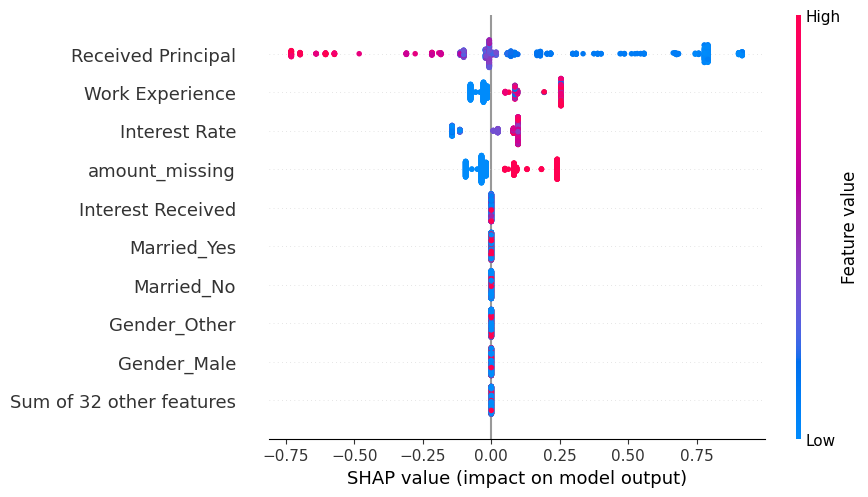

In [68]:
# Create a SHAP TreeExplainer
explainer = shap.TreeExplainer(final_model_xgb)

# Calculate SHAP values for the testing data

dmatrix_test = xgb.DMatrix(test_x, enable_categorical=True) # Optional. Use if you have categorical data in processed data

shap_values = explainer(test_x_FN) #getting shap values for each row of our data

# summarize the effects of all the features
shap.plots.beeswarm(shap_values)
# shap.plots.bar(shap_values)

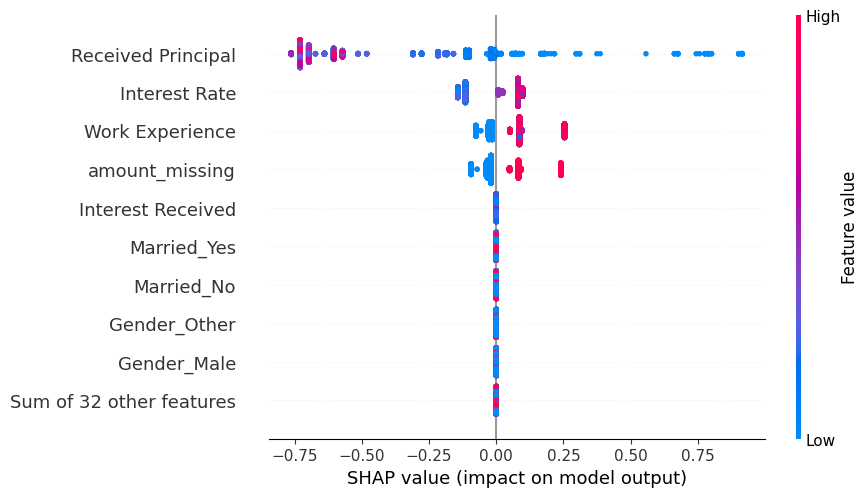

In [69]:
# Create a SHAP TreeExplainer
explainer = shap.TreeExplainer(final_model_xgb)

# Calculate SHAP values for the testing data

dmatrix_test = xgb.DMatrix(test_x_FP, enable_categorical=True) # Optional. Use if you have categorical data in processed data

shap_values = explainer(test_x_FP)

# summarize the effects of all the features
shap.plots.beeswarm(shap_values)
# shap.plots.bar(shap_values)

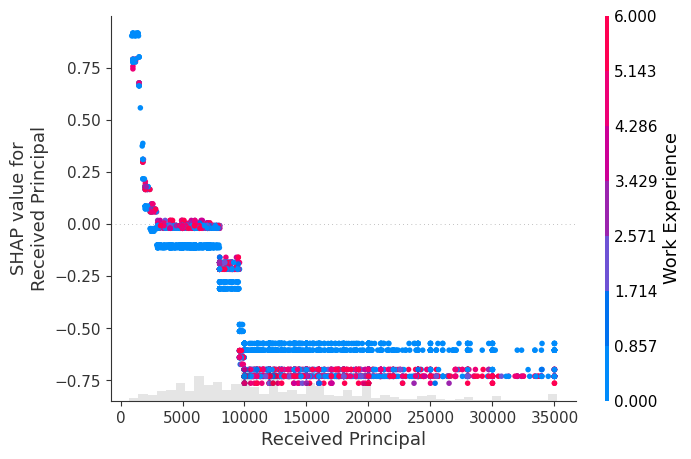

In [70]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.plots.scatter(shap_values[:,"Received Principal"], color=shap_values)

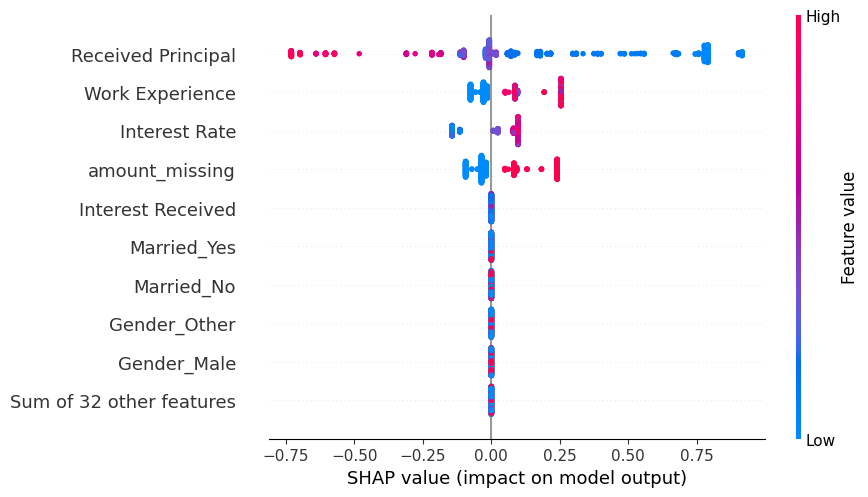

In [71]:
# Create a SHAP TreeExplainer
explainer = shap.TreeExplainer(final_model_xgb)

# Calculate SHAP values for the testing data

dmatrix_test = xgb.DMatrix(test_x_FN, enable_categorical=True) # Optional. Use if you have categorical data in processed data

shap_values = explainer(test_x_FN)

# summarize the effects of all the features
shap.plots.beeswarm(shap_values)

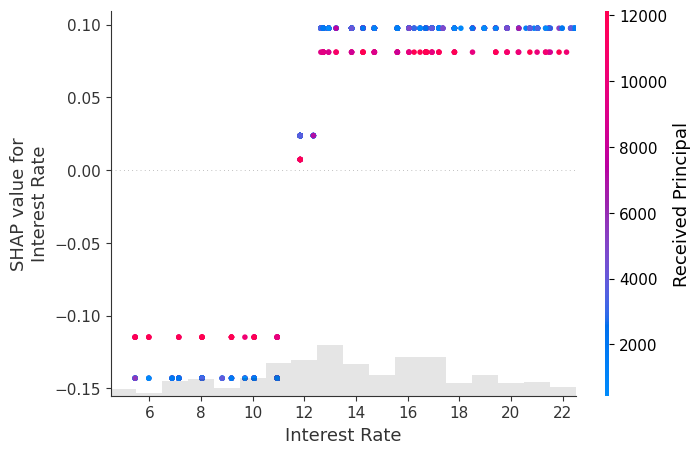

In [72]:
shap.plots.scatter(shap_values[:,"Interest Rate"], color=shap_values)


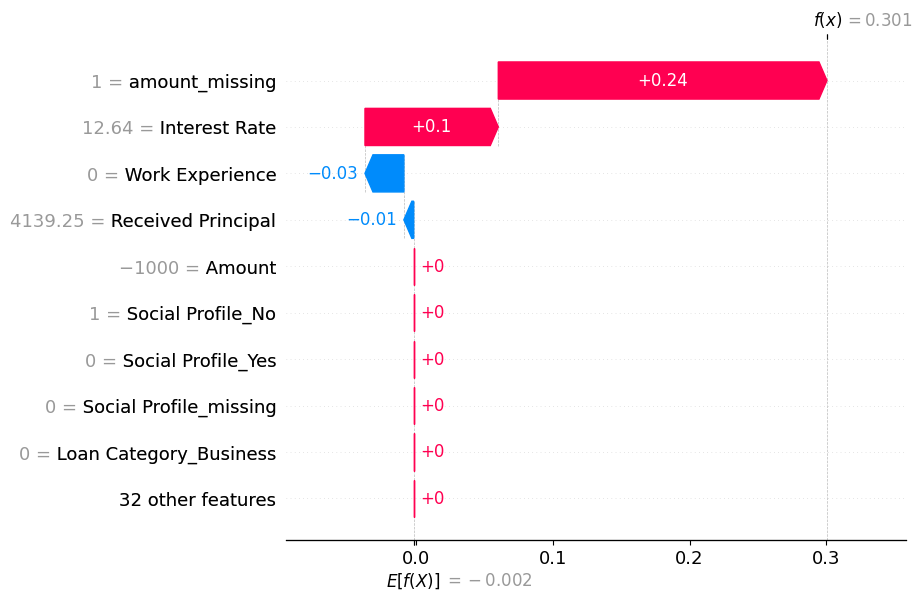

In [73]:
# visualize the first prediction's explanation
shap.plots.waterfall(shap_values[1])

In [74]:
from scipy.spatial.qhull import QhullError


In [77]:
import pandas as pd
from alibi.explainers import AnchorTabular


"""Initialize and train the anchor model"""
predict_fn = lambda x: final_model_xgb.predict_proba(x)
explainer = AnchorTabular(predict_fn, feature_names=train_x.columns)
# Fit the explainer with reference data
explainer.fit(train_x.values)

"""Find Anchor of customer at index 0"""
idx = 0 # record we would like to explain using anchors
class_names = ["No Default","Default"]
print(train_x[idx:idx+1])
print('Prediction: ', class_names[explainer.predictor(train_x[idx:idx+1].values)[0]])

explanation = explainer.explain(train_x[idx:idx+1].values, threshold=0.95)
print('Anchor: %s' % (' AND '.join(explanation.anchor)))
print('Precision: %.2f' % explanation.precision)
print('Coverage: %.2f' % explanation.coverage)

# meaning 25% of the defaults can be explained using this anchor (Anchor: Received Principal <= 2038.73)
# with a precision of 96% which is really high

         Amount  Interest Rate  Tenure(years)  Tier of Employment  \
66703  144705.0          15.48              6                 7.0   

       Work Experience  Total Income(PA)  Dependents  Delinq_2yrs  \
66703              0.0           29440.0           1            1   

       Total Payement   Received Principal  ...  Loan Category_Home  \
66703          2981.84             1382.64  ...                   0   

       Loan Category_Medical   Loan Category_Other   Employmet type_Salaried  \
66703                       0                     0                        0   

       Employmet type_Self - Employeed  Employmet type_missing  \
66703                                0                       1   

       Is_verified_Not Verified  Is_verified_Source Verified  \
66703                         0                            0   

       Is_verified_Verified  Is_verified_missing  
66703                     0                    1  

[1 rows x 41 columns]
Prediction:  Default
Anchor: Re

In [88]:
"""Initialize Anchor instance and train the model"""
import pandas as pd
from alibi.explainers import AnchorTabular


predict_fn = lambda x: final_model_xgb.predict_proba(x)

explainer = AnchorTabular(predict_fn, feature_names=test_x_FP.columns)

# Fit the explainer with reference data
explainer.fit(test_x.values)

AnchorTabular(meta={
  'name': 'AnchorTabular',
  'type': ['blackbox'],
  'explanations': ['local'],
  'params': {'seed': None, 'disc_perc': (25, 50, 75)},
  'version': '0.9.2'}
)

In [89]:
"""case 1 : actual=0 and prediction=0"""

test_x_TP, test_y_TP= filter_test_data_based_actual_prediction(test_x, test_y, y_pred, actual=0, prediction=0 )

idx = 2 # record we would like to explain using anchors
class_names = ["No Default","Default"]

print('Prediction: ', class_names[explainer.predictor(test_x_TP[idx:idx+1].values)[0]])

explanation = explainer.explain(test_x_TP[idx:idx+1].values, threshold=0.95)
print('Anchor: %s' % (' AND '.join(explanation.anchor)))
print('Precision: %.2f' % explanation.precision)
print('Coverage: %.2f' % explanation.coverage)


Prediction:  No Default
Anchor: Received Principal > 8512.08
Precision: 0.97
Coverage: 0.25


In [90]:
"""case 2 : Loan denied: actual=1 and prediction=1"""

test_x_TN, test_y_TN= filter_test_data_based_actual_prediction(test_x, test_y, y_pred, actual=1, prediction=1 )

idx = 2 # record we would like to explain using anchors
class_names = ["No Default","Default"]

print('Prediction: ', class_names[explainer.predictor(test_x_TN[idx:idx+1].values)[0]])

explanation = explainer.explain(test_x_TN[idx:idx+1].values, threshold=0.95)
print('Anchor: %s' % (' AND '.join(explanation.anchor)))
print('Precision: %.2f' % explanation.precision)
print('Coverage: %.2f' % explanation.coverage)


Prediction:  Default
Anchor: Work Experience > 0.00 AND Received Principal <= 8512.08
Precision: 0.98
Coverage: 0.13


In [3]:
import tensorflow as tf
tf.get_logger().setLevel(40) # suppress deprecation messages
tf.compat.v1.disable_v2_behavior() # disable TF2 behaviour as alibi code still relies on␣
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from alibi.explainers import CounterfactualProto
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
import pickle

In [78]:
"""Data Preprocessing and model building"""

#Reading Data
data=pd.read_excel(r'D:\Megha\PPro\to-do\risk-guard\risk-guard\modular_code\Input\Cleaned_SampledData.xlsx')

# Assuming `target_column` is the name of the target variable column
target_column="Defaulter"
X = data.drop(target_column, axis=1)
y = data[target_column]

#List of all features
feature_names = X.columns.tolist()

# Convert X to a NumPy array
X = X.to_numpy()

# Convert y to a NumPy array
y = y.to_numpy()

# Standardize data
mu = X.mean(axis=0)
sigma = X.std(axis=0)
X = (X - mu) / sigma

# Split data into test and train
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [92]:

# # Train the final RF model with the best hyperparameters
# final_model1 = RandomForestClassifier(
#     max_depth=None,
#     min_samples_split=2,
#     n_estimators=100,
#      # Use GPU for faster training (if available)
# )

# final_model1.fit(x_train, y_train)  # Train the final model on the entire dataset


# # Save the trained model using pickle for future use
# with open('loan.pkl', 'wb') as file:
#     pickle.dump(final_model1, file)



In [80]:

# Open the pickle file in read mode
with open('loan.pkl', 'rb') as file:
    # Load the saved model from the pickle file
    final_model1 = pickle.load(file)

# Use the loaded model to make predictions on the test data
score = final_model1.score(x_test, y_test)

# Take a single example from the test_x data and reshape it into a 2D array
X = x_test[1].reshape((1,) + x_test[1].shape)

# Retrieve the shape of the reshaped array
shape = X.shape

In [81]:
"""Building a Counterfactual Model"""

# The model is assumed to be already defined and stored in the variable `final_model1`

# Initialize the explainer and specify the predict function
# The predict function takes an input `x` and returns the predicted class probabilities
predict_fn = lambda x: final_model1.predict_proba(x)

# Create the counterfactual explainer object
# The `CounterfactualProto` class is used for counterfactual explanations
# It takes the predict function, shape of the input, and other parameters
cf = CounterfactualProto(predict_fn, shape, use_kdtree=True, theta=10., max_iterations=1000,
                         feature_range=(x_train.min(axis=0), x_train.max(axis=0)),
                         c_init=1., c_steps=10)

# Fit the explainer to the training data
cf.fit(x_train)

No encoder specified. Using k-d trees to represent class prototypes.


CounterfactualProto(meta={
  'name': 'CounterfactualProto',
  'type': ['blackbox', 'tensorflow', 'keras'],
  'explanations': ['local'],
  'params': {
              'kappa': 0.0,
              'beta': 0.1,
              'gamma': 0.0,
              'theta': 10.0,
              'cat_vars': None,
              'ohe': False,
              'use_kdtree': True,
              'learning_rate_init': 0.01,
              'max_iterations': 1000,
              'c_init': 1.0,
              'c_steps': 10,
              'eps': (0.001, 0.001),
              'clip': (-1000.0, 1000.0),
              'update_num_grad': 1,
              'write_dir': None,
              'feature_range': (array([-0.66780218, -1.87626245, -0.6204565 , -1.81516863, -0.46770716,
       -1.33082588, -1.41484468, -0.34268247, -1.16841744, -1.00779207,
       -0.9357944 , -0.05302204, -0.64750285, -0.70826748, -0.70135535,
       -0.71171059, -0.70540964, -0.70604438, -0.70986907, -0.92478053,
       -0.01988813, -0.02217181, -0.315

In [82]:

idx= 0
print(x_test[idx])
# Take a single example from the test_x data and reshape it into a 2D array
X = x_test[idx].reshape((1,) + x_test[idx].shape)

# Generate a counterfactual explanation for the input example X
explanation = cf.explain(X)
print(X)
print(f'Original prediction: {explanation.orig_class}')
print(f'Counterfactual prediction: {explanation.cf["class"]}')

[-0.66780218  0.06807712 -0.6204565  -1.06360356 -0.46770716 -0.2833537
  0.71124183  3.5526323   1.23231051  0.88025086  0.95978846 -0.05302204
  1.54439475  1.41189597 -0.70135535 -0.71171059 -0.70540964 -0.70604438
  1.40871048 -0.92478053 -0.01988813 -0.02217181 -0.31576822  1.11122263
 -0.70883584 -0.70906201  1.42161107  6.26113822 -0.10442335 -1.2573271
 -0.51297425 -0.2614001  -0.10887816 -0.26969993  1.42288114 -0.3289885
 -1.15537305  1.72833549 -0.5800216  -0.57215528 -0.57863274]
[[-0.66780218  0.06807712 -0.6204565  -1.06360356 -0.46770716 -0.2833537
   0.71124183  3.5526323   1.23231051  0.88025086  0.95978846 -0.05302204
   1.54439475  1.41189597 -0.70135535 -0.71171059 -0.70540964 -0.70604438
   1.40871048 -0.92478053 -0.01988813 -0.02217181 -0.31576822  1.11122263
  -0.70883584 -0.70906201  1.42161107  6.26113822 -0.10442335 -1.2573271
  -0.51297425 -0.2614001  -0.10887816 -0.26969993  1.42288114 -0.3289885
  -1.15537305  1.72833549 -0.5800216  -0.57215528 -0.57863274]

In [95]:
# Calculate the original input
orig = X * sigma + mu

# Calculate the counterfactual input based on the explanation
counterfactual = explanation.cf['X'] * sigma + mu

# Calculate the difference between the counterfactual and original inputs
delta = counterfactual - orig

# Iterate through the features and print differences that exceed a threshold
for i, f in enumerate(feature_names):
    # Check if the absolute difference exceeds a threshold (1e-4 in this case)
    if np.abs(delta[0][i]) > 1e-4:
        # Print the feature name and its corresponding difference value
        print(f'{f}: {delta[0][i]}')


Amount: 0.0027489295171108097
Total Income(PA): 0.0006970225949771702
Total Payement : 0.00014925854338798672
Received Principal: 3061.723030806974
Married_Yes: 0.13098873404219621
Married_missing: -0.1295906843654464
Social Profile_Yes: 0.12988362256025013
Social Profile_missing: -0.1319598358576326


In [96]:
# Loan approved data
idx= -2
# Take a single example from the test_x data and reshape it into a 2D array
X = x_test[idx].reshape((1,) + x_test[idx].shape)

# Generate a counterfactual explanation for the input example X
explanation = cf.explain(X)

print(f'Original prediction: {explanation.orig_class}')
print(f'Counterfactual prediction: {explanation.cf["class"]}')


# Calculate the original input
orig = X * sigma + mu

# Calculate the counterfactual input based on the explanation
counterfactual = explanation.cf['X'] * sigma + mu

# Calculate the difference between the counterfactual and original inputs
delta = counterfactual - orig

# Iterate through the features and print differences that exceed a threshold
for i, f in enumerate(feature_names):
    # Check if the absolute difference exceeds a threshold (1e-4 in this case)
    if np.abs(delta[0][i]) > 1e-4:
        # Print the feature name and its corresponding difference value
        print(f'{f}: {delta[0][i]}')

No counterfactual found!


Original prediction: 0


TypeError: 'NoneType' object is not subscriptable

## **Bonus: Counterfactuals using Microsoft Dice for sklearn models**

In [ ]:
import sys
print(sys.path)


In [ ]:
import sys
sys.path.append('C:\\Users\\user\\anaconda3\\lib\\site-packages\\dice_ml')


In [ ]:
import dice_ml
from dice_ml.utils import helpers
from sklearn.model_selection import train_test_split  # Import train_test_split function


# Create a copy of the training features dataset
dataset = train_x.copy()

# Add a new column called "Defaulter" to the dataset
# and assign the corresponding target labels from the training set
dataset["Defaulter"] = train_y

# Select columns from the dataset that have the data type 'uint8'
uint8_columns = dataset.select_dtypes(include='uint8').columns


# Convert the columns with the data type 'uint8' to 'int' in the dataset
dataset[uint8_columns] = dataset[uint8_columns].astype('int')


target = dataset["Defaulter"]  # Define the target variable as the "Defaulter" column

# Split the dataset into training and testing datasets
train_dataset, test_dataset, _, _ = train_test_split(dataset,
                                                     target,
                                                     test_size=0.2,
                                                     random_state=0,
                                                     stratify=target)

continuous_features = ['Amount', 'Interest Rate', 'Tenure(years)', 'Tier of Employment', 'Work Experience', 'Total Income(PA)', 'Dependents', 'Delinq_2yrs',
                       'Total Payement ', 'Received Principal', 'Interest Received', 'Number of loans', 'amount_missing', 'Gender_Female', 'Gender_Male', 'Gender_Other',
                       'Married_No', 'Married_Yes', 'Married_missing', 'Home_mortgage', 'Home_none', 'Home_other', 'Home_own', 'Home_rent', 'Social Profile_No',
                       'Social Profile_Yes', 'Social Profile_missing', 'Loan Category_Business', 'Loan Category_Car ', 'Loan Category_Consolidation', 'Loan Category_Credit Card',
                       'Loan Category_Home', 'Loan Category_Medical ', 'Loan Category_Other ', 'Employmet type_Salaried', 'Employmet type_Self - Employeed', 'Employmet type_missing',
                       'Is_verified_Not Verified', 'Is_verified_Source Verified', 'Is_verified_Verified', 'Is_verified_missing']



In [ ]:
# Create a DiCE Data object with the training dataset and specified continuous features
d = dice_ml.Data(dataframe=train_dataset,
                 continuous_features=continuous_features,
                 outcome_name='Defaulter')

# Create a DiCE Model object with the pre-trained ML model
m = dice_ml.Model(model=final_model_xgb, backend="sklearn")

# Create a DiCE explanation instance using the Data and Model objects
exp = dice_ml.Dice(d, m, method='genetic')

query_instance = test_dataset.drop(columns="Defaulter")[0:1]  # Select the first instance from the test dataset without the 'Defaulter' column as the query instance
dice_exp = exp.generate_counterfactuals(query_instance, total_CFs=4, desired_class="opposite")  # Generate counterfactual explanations for the query instance with a total of 4 counterfactuals, aiming for the "opposite" class
dice_exp.visualize_as_dataframe()  # Visualize the counterfactual explanations as a dataframe